In [1]:
import numpy as npimport pandas as pdfrom collections import Counterimport matplotlib.pyplot as pltimport sysfrom pathlib import Pathfrom mnist_classifier.data import MNISTDataModulePROJECT_ROOT = Path().resolve().parents[1]if str(PROJECT_ROOT) not in sys.path:    sys.path.append(str(PROJECT_ROOT))from nn_utils import get_hidden_states, load_modelsfrom local_corex.plotting_utils import (    create_gif_with_differences,     create_perturbation_frames_project,     get_hist_plots,     create_animation_with_differences)from local_corex.data_utils import partition_datafrom local_corex.latent_transformer import CorExWrapper, PCAWrapper

Install CUDA and cudamat (for python) to enable GPU speedups.


In [2]:
base_path = "/home/TomKerby/Research/local_corex_private/scripts/mnist_classifier/model_output/do_classifier/rep_3"
# base_path = "/home/TomKerby/Research/local_corex_private/scripts/mnist_classifier/model_output/base_classifier/rep_1"

from scripts.mnist_classifier.model_output.do_classifier.rep_3.autoencoder_config import conf as ae_conf
# from scripts.mnist_classifier.model_output.base_classifier.rep_1.autoencoder_config import conf as ae_conf
from scripts.mnist_classifier.model_output.do_classifier.rep_3.config import conf as clf_conf
# from scripts.mnist_classifier.model_output.base_classifier.rep_1.config import conf as clf_conf

ae_conf = ae_conf['autoencoder']
# ae_ckpt = base_path + '/mnist_ae_epoch=084-val_loss=0.5200.ckpt'
ae_ckpt = base_path + '/mnist_ae_epoch=069-val_loss=0.5778.ckpt'
clf_conf = clf_conf['classifier']
# clf_ckpt = base_path + '/mnist_clf_epoch=042-val_loss=0.0024.ckpt'
clf_ckpt = base_path + '/mnist_clf_epoch=053-val_loss=0.0024.ckpt'

do_ae, do_clf = load_models(ae_ckpt, clf_ckpt, ae_conf, clf_conf)

data_module = MNISTDataModule(clf_conf, "/home/TomKerby/Research/local_corex_private/scripts/mnist_classifier")
data_module.setup('predict')

model_data = get_hidden_states(do_clf, data_module, device=do_clf.device, num_layers=len(clf_conf['hidden_layers']))

inputs=model_data[4]
labels=model_data[5]

do_state_df = pd.DataFrame({
    'input': list(inputs),
    'h1': list(model_data[1]),
    'h2': list(model_data[2]),
    'h3': list(model_data[3]),
    'output': list(model_data[0])
})

Calculating PHATE...
  Running PHATE on 10000 observations and 784 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.93 seconds.
    Calculating KNN search...
    Calculated KNN search in 2.37 seconds.
    Calculating affinities...
    Calculated affinities in 0.06 seconds.
  Calculated graph and diffusion operator in 3.38 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.54 seconds.
    Calculating KMeans...
    Calculated KMeans in 1.40 seconds.
  Calculated landmark operator in 2.50 seconds.
  Calculating optimal t...
    Automatically selected t = 25
  Calculated optimal t in 0.96 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.30 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 56.03 seconds.
Calculated PHATE in 63.15 seconds.
Group number: 0 Counter({1: 421, 7: 8, 4: 7, 9: 6, 6: 1})
Group number: 1 Counter({3: 870, 5: 381, 8: 105, 9: 9,

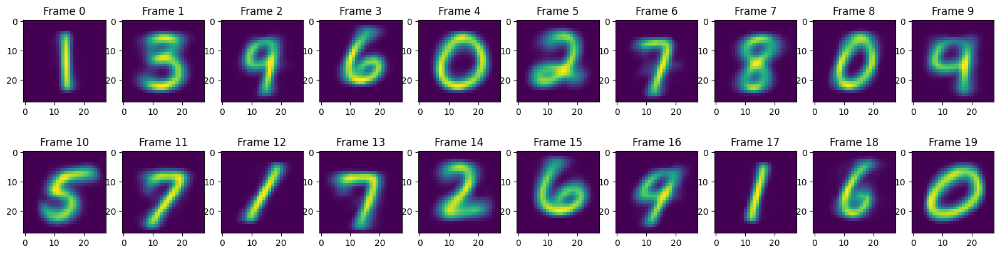

In [3]:
num_clusters=20
indexes = partition_data(inputs, n_partitions=num_clusters, phate_dim=10, n_jobs=-2, seed=42)
for i in range(0, num_clusters):
    print("Group number:", i, Counter(labels[indexes[i]]))

fig, axes = plt.subplots(2, 10, figsize=(20, 5))

for i, ax in enumerate(axes.flatten()):
    ax.imshow(np.mean(inputs[indexes[i]], axis = 0).reshape(28,28))
    ax.set_title('Frame ' + str(i))

In [6]:
import os

def build_gifs(model_data, indexes, partition, comps=[i for i in range(10)], fps=10, model_type='corex', n_comps=50, n_frames=50):
    models = []
    for i in range(len(ae_conf['encoder_layers'])):
        layer = i + 1
        dir_path = f"gifs/partition_{partition}/layer_{layer}"
        if not os.path.exists(dir_path):
            os.makedirs(dir_path)
            
        x = np.concatenate([model_data[layer][indexes[partition]], model_data[0][indexes[partition]]], axis=1)   
        
        if model_type == 'corex':
            model = CorExWrapper(n_comps)
        elif model_type == 'pca':
            model = PCAWrapper(n_comps)
        else:
            raise Exception('model_type not supported. Valid options are: "corex", "pca"')
          
        model.fit(x)
        models.append(model)
        z=model.transform(x)

        for comp in comps:
            perturbed_vals = np.linspace(np.min(z[:,comp]), np.max(z[:,comp]), n_frames)
            # perturbed_vals = np.linspace(np.quantile(z, .001), np.quantile(z, .999), n_frames)
            frames, data = create_perturbation_frames_project(
                perturbed_vals, model, do_ae, factor=comp, latent_dim=ae_conf['encoder_layers'][i], encoder_layer=layer, input_dim=(28,28)
            )
            hist_frames = get_hist_plots(z, perturbed_vals)
            create_gif_with_differences(frames, data, hist_frames, gif_path=dir_path + f'/{partition}_{layer}_{model.model_type}_{comp}.gif', fps=fps)
    return models

In [10]:
corex_16_models = build_gifs(
    model_data, indexes, 16, comps=[i for i in range(10)], 
    fps=10, model_type='corex', n_comps=100, n_frames=50
)
pca_16_models = build_gifs(
    model_data, indexes, 16, comps=[i for i in range(10)], 
    fps=10, model_type='pca', n_comps=100, n_frames=50
)
corex_8_models = build_gifs(
    model_data, indexes, 8, comps=[i for i in range(10)], 
    fps=10, model_type='corex', n_comps=100, n_frames=50
)
pca_8_models = build_gifs(
    model_data, indexes, 8, comps=[i for i in range(10)], 
    fps=10, model_type='pca', n_comps=100, n_frames=50
)
corex_1_models = build_gifs(
    model_data, indexes, 1, comps=[i for i in range(10)], 
    fps=10, model_type='corex', n_comps=100, n_frames=50
)
pca_1_models = build_gifs(
    model_data, indexes, 1, comps=[i for i in range(10)], 
    fps=10, model_type='pca', n_comps=100, n_frames=50
)

GIF saved to gifs/partition_16/layer_1/16_1_corex_0.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_1.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_2.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_3.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_4.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_5.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_6.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_7.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_8.gif
GIF saved to gifs/partition_16/layer_1/16_1_corex_9.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_0.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_1.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_2.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_3.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_4.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_5.gif
GIF saved to gifs/partition_16/layer_2/16_2_corex_6.gif
GIF saved to gifs/partition_16/layer_2/16_2_core

In [17]:
def create_animation(x, model, ae_conf, factor=7, layer=3, num_frames=200):
    z=model.transform(x)
    perturbed_vals = np.linspace(np.min(z[:,factor]), np.max(z[:,factor]), num_frames)

    frames, data = create_perturbation_frames_project(
        perturbed_vals, model, do_ae, factor=factor, latent_dim=ae_conf['encoder_layers'][layer - 1], encoder_layer=layer, input_dim=(28,28)
    )

    hist_frames = get_hist_plots(z, perturbed_vals)
    # create_gif_with_differences(frames, data, hist_frames, gif_path=f'test.gif', fps=5)
    ani = create_animation_with_differences(frames, data, hist_frames, fps=5, concat_axis=1)
    return ani

In [18]:
from IPython.display import HTML

partition=8
layer=3
n_comps = 100
x = np.concatenate([model_data[layer][indexes[partition]], model_data[0][indexes[partition]]], axis=1) 
    
model = CorExWrapper(n_comps)
# model = PCAWrapper(100)
model.fit(x)

ani = create_animation(x, model, ae_conf, factor=7, layer=3, num_frames=200)
HTML(ani.to_jshtml())

In [19]:
partition=8
layer=3
n_comps = 100
x = np.concatenate([model_data[layer][indexes[partition]], model_data[0][indexes[partition]]], axis=1) 
    
# model = CorExWrapper(n_comps)
model = PCAWrapper(n_comps)
model.fit(x)

ani_1 = create_animation(x, model, ae_conf, factor=5, layer=3, num_frames=200)
HTML(ani_1.to_jshtml())